In [74]:
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
%matplotlib inline

In [75]:
df = pd.read_csv("dataset.csv")
df.head()

,Unnamed: 0,open,high,low,close,volume,marketCap,timestamp,crypto_name,date
0,0,112.900002,118.800003,107.142998,115.910004,0.0,1.288693e+09,2013-05-05T23:59:59.999Z,Bitcoin,2013-05-05
1,1,3.493130,3.692460,3.346060,3.590890,0.0,6.229819e+07,2013-05-05T23:59:59.999Z,Litecoin,2013-05-05
2,2,115.980003,124.663002,106.639999,112.300003,0.0,1.249023e+09,2013-05-06T23:59:59.999Z,Bitcoin,2013-05-06
3,3,3.594220,3.781020,3.116020,3.371250,0.0,5.859436e+07,2013-05-06T23:59:59.999Z,Litecoin,2013-05-06
4,4,112.250000,113.444000,97.699997,111.500000,0.0,1.240594e+09,2013-05-07T23:59:59.999Z,Bitcoin,2013-05-07


In [76]:
df = df[df.crypto_name != 'Litecoin']

In [77]:
df = df[df.volume != 0.0]

In [78]:
df.drop(['Unnamed: 0', 'low', 'close', 'high', 'marketCap', 'crypto_name', 'timestamp', 'date'], axis='columns', inplace=True)

In [79]:
df.head()

,open,volume
629,763.280029,46862700.0
631,0.000603,477422.0
632,0.024426,148422.0
633,0.027554,143404.0
634,0.000524,341581.0


Text(0, 0.5, 'volume')

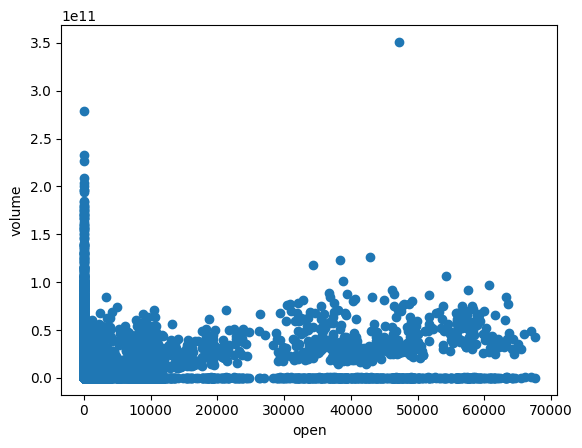

In [80]:
plt.scatter(df.open,df['volume'])
plt.xlabel('open')
plt.ylabel('volume')

In [81]:
km = KMeans(n_clusters=3)
km

KMeans(n_clusters=3)

In [82]:
y_predicted = km.fit_predict(df)
y_predicted

array([0, 0, 0, ..., 0, 0, 0])

In [83]:
df['cluster']=y_predicted
df.head()

,open,volume,cluster
629,763.280029,46862700.0,0
631,0.000603,477422.0,0
632,0.024426,148422.0,0
633,0.027554,143404.0,0
634,0.000524,341581.0,0


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


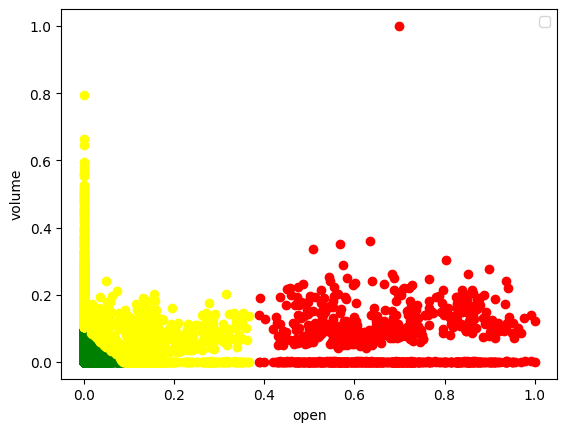

In [94]:
df1 = df[df.cluster==0]
df2 = df[df.cluster==1]
df3 = df[df.cluster==2]
plt.scatter(df1.open,df1['volume'],color='green')
plt.scatter(df2.open,df2['volume'],color='red')
plt.scatter(df3.open,df3['volume'],color='yellow')

plt.xlabel('open')
plt.ylabel('volume')
plt.legend()

In [103]:
# Preprocessing using min max scaler

In [95]:
scaler = MinMaxScaler()

scaler.fit(df[['volume']])
df['volume'] = scaler.transform(df[['volume']])
df

scaler.fit(df[['open']])
df['open'] = scaler.transform(df[['open']])
df

,open,volume,cluster
629,1.129953e-02,1.335242e-04,0
631,8.926622e-09,1.360301e-06,0
632,3.616076e-07,4.228933e-07,0
633,4.079054e-07,4.085957e-07,0
634,7.756744e-09,9.732541e-07,0
...,...,...,...
72941,3.346242e-07,1.151140e-04,0
72942,2.173574e-05,8.104304e-05,0
72943,7.328571e-05,3.047278e-04,0
72944,3.443015e-09,6.106735e-04,0


In [96]:
km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(df[['open', 'volume']])
y_predicted

array([0, 0, 0, ..., 0, 0, 0])

In [97]:
df['cluster']=y_predicted
df

,open,volume,cluster
629,1.129953e-02,1.335242e-04,0
631,8.926622e-09,1.360301e-06,0
632,3.616076e-07,4.228933e-07,0
633,4.079054e-07,4.085957e-07,0
634,7.756744e-09,9.732541e-07,0
...,...,...,...
72941,3.346242e-07,1.151140e-04,0
72942,2.173574e-05,8.104304e-05,0
72943,7.328571e-05,3.047278e-04,0
72944,3.443015e-09,6.106735e-04,0


In [98]:
km.cluster_centers_

array([[0.00149241, 0.00251186],
       [0.67190252, 0.06227515],
       [0.09896504, 0.08563871]])

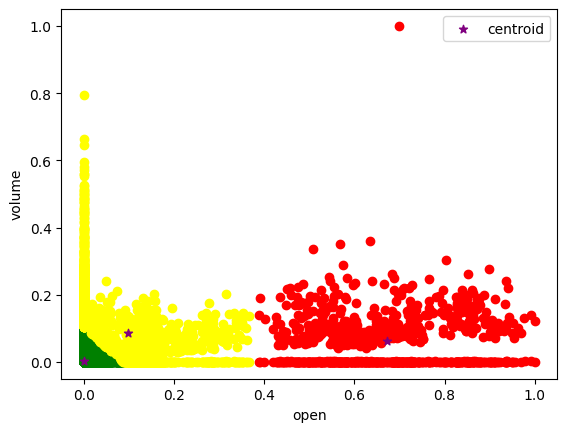

In [99]:
df1 = df[df.cluster==0]
df2 = df[df.cluster==1]
df3 = df[df.cluster==2]
plt.scatter(df1.open,df1['volume'],color='green')
plt.scatter(df2.open,df2['volume'],color='red')
plt.scatter(df3.open,df3['volume'],color='yellow')
plt.scatter(km.cluster_centers_[:,0],km.cluster_centers_[:,1],color='purple',marker='*',label='centroid')

plt.xlabel('open')
plt.ylabel('volume')
plt.legend()

In [ ]:
# Elbow Plot

In [101]:
sse = []
k_rng = range(1,10)
for k in k_rng:
    km = KMeans(n_clusters=k)
    km.fit(df)
    sse.append(km.inertia_)

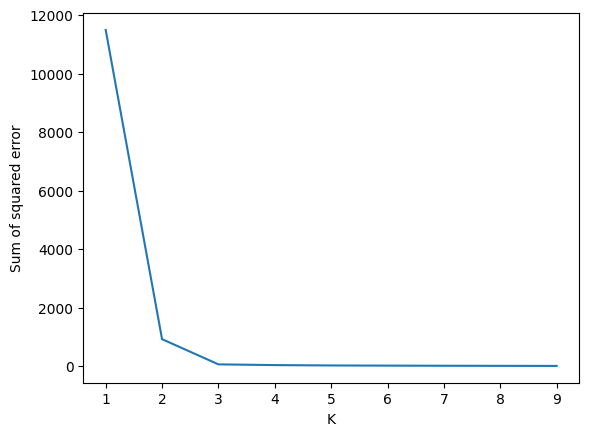

In [93]:
plt.xlabel('K')
plt.ylabel('Sum of squared error')
plt.plot(k_rng,sse)